## This scripts takes bags of words previously generated (using steps 2 to 4) to perform frequency analysis, generate a climateVSdamage ratio and plot the time series

In [42]:
import warnings
warnings.filterwarnings("ignore")

In [1]:
# !pip install wheel
# !pip install pandas

In [24]:
climate = ['acclimatisation', 'adaptation', 'air', 'water',  
           'airflow', 'desiccant', 'evaporation','atmosphere','gases', 'oceans', 'ice', 'sunlight', 'snow','autumn',
           'cold', 'dehumidify','moist', 'pre-heat', 'humidify', 'condense', 'dehumidifying', 'floods', 'storms', 'cyclones', 'dry', 'wet', 
           'winter', 'summer', 'hot', 'rain', 'rainy', 'ecology', 
            'biodiversity', 'biological','ecosystems','climate', 'nature', 
            'ecological', 'environments', 'environs','firestorm', 'flooding', 
           'coastal', 'deforestation', 'desertification', 'hailstorm', 'heat',
           'cooling','monsoon', 'droughts', 'heatwaves','seasons', 'hurricanes', 'summers', 'natural', 
           'geological','weather-related','climate-related',
           'precipitation','Arctic', 'melting', 'summertime', 'downpours',
           'sunny', 'cloudy', 'temperature', 'humidity', 'pressure','thaw','Superheated', 'thawing', 'permafrost', 
           'typhoon', 'evapotranspiration','warming', 'warmth','weather', 'climatic', 'rainfall', 'wind', 'sun', 'spring']


In [25]:
damage = ['affect', 'alter', 'exacerbate', 'threaten', 'trigger', 'cause', 'disrupt', 'aggravate', 'worsen','outbreak', 'alarm','alienate',
        'threat','conflict','violence', 'shocks', 'exacerbation', 'attack','backlash', 
         'prevalence','consequences','brunt', 'burdens', 'impact', 'burn', 'lose', 'damage', 
        'degradation', 'loss', 'threats', 'exposure', 'hazards', 'erosion','dangerous', 'severe', 'catastrophic',
        'susceptible', 'fragile', 'intense','deformation', 'damping', 'deflection', 'ill-health', 'depression', 'irritations', 
        'deprivation', 'injury,', 'detriment', 'difficult', 'hard', 'dismay','distort', 'disturb', 'prohibit', 'diminish','deplete', 
        'obstruct','infect', 'dread', 'influence', 'effects', 'aggressively', 'endanger','endangerment','epidemic','erode','inhibit',
        'eruption','destabilisations', 'extreme','distract',  'fear','danger','unstable', 'Pandemic', 'grievous','harm', 'exacerbate',
        'alter', 'intensify','stress', 'disasters', 'hit','harmed', 'worst','triggered',  'hurt', 'reduce','burden',
        'impair', 'provoke', 'destroy', 'degrade', 'weaken', 'lessen', 'impairment','impede', 'obstacle', 'inconvenience', 'impart',
        'overwhelms', 'violate', 'weaken', 'jeopardy','life-threatening','loss', 'losses', 'destruction', 'damage', 'stress', 'die',
        'outbreak', 'worsened','shortfall',  'fight', 'paralyzed', 'deregulation', 'peril','misuse','reduce', 'minimizing', 'lowering',
        'limiting', 'reduction', 'decreasing', 'reductions','repercussion', 'toughness','vulnerability', 'risk,','scare', 'devastating',
        'strains', 'restriction','terrible', 'terror', 'threat', 'challenge', 'concern', 'problem',  'serious', 'causes', 'crisis',
        'unmanageable', 'mismatch', 'wastage', 'undersupply','wicked',  'worry','wound']

In [5]:
# ##Bags of The Words geneated using the scripts Step2-4_geenrate_bags_of_words

# climate1 = ['acclimatisation','adaptation', 'mitigation',  'adaption','air', 'water', 'groundwater', 'dehumidifier',  'atmosphere', 
#            'oceans', 'gases',  'autumn', 'overcast', 'cold', 'hot', 'dry', 'warm', 'wet', 'humid', 'winter', 'summer', 'condensation',
#            'cool', 'pressures', 'zones', 'dehumidify',  'oxygen-depleted', 'pre-heat', 'precool', 'glaciers', 'melting', 'ice', 
#            'Superheated','ecological', 'ecosystems', 'environment','climate', 'nature','firestorm', 'coastal', 'vegetation', 'airflow',
#            'habitat', 'biodiversity',  'fires', 'evaporation', 'hailstorm', 'Heat', 'cooling', 'heat', 'hurricanes',  
#            'droughts', 'natural', 'geological', 'weather-related', 'climate-related','ecosystem', 'radiation', 'irradiation',  'sunlight', 
#            'Arctic', 'precipitation', 'ocean', 'rain', 'ice', 'rainstorm', 'rockslide', 'monsoon', 'spring','snowstorm', 'spring',
#            'rainy', 'springtime', 'storm', 'floods', 'drought', 'flooding',  'storms', 'cyclones', 'wildfires', 'periods','seasons',
#            'spring', 'sunny',  'summertime','unpredictable', 'urbanisation','intensity','sunshine', 'surroundings', 'temperatures', 
#            'temperature', 'humidity', 'thaw', 'landslides','thawing', 'typhoon','upwind','warming', 'warmth',  'wave', 'waves', 
#            'weather', 'climatic', 'rainfall', 'wind','sun', 'lighting', 'season', 'daytime', 'wintertime','respiration']

# damage1 = ['affect', 'exacerbate', 'alter', 'threaten', 'cause',  'worsen', 'trigger', 'outbreak','occurrence', 'desert', 'alienate', 
#           'anxiety', 'hazards', 'discord','violence','concerns', 'attack', 'bother', 'burden', 'strain', 'burn','consequence', 'curse', 
#           'damage', 'damages', 'shocks', 'harm', 'exposure', 'risks', 'disease', 'dangerous', 'catastrophic', 'susceptible','inhospitable',
#           'fragile', 'deformation', 'Inhibition','depression', 'deprivation', 'injury', 'detriment', 'difficult', 'easy', 'easier', 
#           'feasible', 'convenient','possible', 'beneficial', 'harder', 'dismay','perishing', 'weaken', 'impose', 'dominate',  
#           'distortion','disturb', 'ignite', 'supervise', 'issues', 'lessen', 'prohibit',  'dread', 'effect', 'influence', 
#           'effects', 'evolution', 'characteristics', 'uncertainty', 'effectuate','epidemic', 'erode', 'disrupt', 'destroy', 
#           'endanger', 'hinder', 'suppress', 'eruption','expose', 'kill', 'starve', 'severe', 'extremes',
#           'intense', 'flooding', 'disappear', 'vanish', 'turn', 'falls', 'fear', 'fears', 'citizens', 'danger', 'victims', 'grave', 
#           'starving','(dis)trust',  'corruption', 'failures', 'grievous','hard','impossible', 'harm','threats', 'stress','disaster—like',
#           'exhaustion', 'stroke', 'helplessness','against', 'hit', 'impacted', 'hardest', 'harmed', 'tornadoes','destroyed', 'killed',
#           'horror', 'hurt', 'distort', 'obstruct', 'unfold', 'impact', 'implications', 'impair', 'inconvenience','induce', 'inhibit',
#           'resist', 'intensify', 'aﬀect', 'incidental', 'infect','exacerbation',  'invasive', 'influences',
#           'impacts', 'hardship','insecurity', 'burdens,', 'shortages', 'degradation','vulnerability', 'weariness', 'pandemic','problem', 'concern', 'jeopardize',
#           'sickness','jeopardy','raised', 'preventable', 'substantial', 'undernutrition', 'subtropics,', 'negligible','overfished',
#           'life-threatening', 'heatwaves', 'hurricanes', 'flooding', 'vector-borne','droughts', 'outbreaks', 'infectious', 
#           'desertification', 'loss', 'losses', 'destruction', 'dissipation', 'stress', 'extraction',
#           'excess', 'intensity', 'menace','risked', 'pandemic','nervousness', 'oppression', 'harshest', 'hardest', 'threatened', 
#           'forcibly', 'uprooted', 'outbreak', 'sudden', 'panic', 'ruined', 'assault', 'paralyzed', 'peril', 'perish',  'aﬀect',  
#           'aggravate', 'devastate', 'reduce', 'intensify','offset', 'decreasing','repercussion', 'unpredictability', 'Influencers', 
#           'clean-up,', 'risk', 'risks', 'vulnerability', 'violence',
#           'causes', 'poverty', 'rapid', 'spread', 'displacement', 'forces', 'serious', 'widespread', 'catastrophic', 'devastating',
#           'bad','severe', 'droughts', 'drought,', 'storms', 'flooding','heavy', 'intense','extreme', 'spoil','fluctuate', 'induce',
#           'strain', 'force', 'stress', 'burden', 'deformation', 'burdens','falling', 'pressures', 'strain', 'force', 'stress', 
#           'burden',  'pressures', 'threat', 'challenge', 'situation', 'crisis',
#           'unmanageable', 'worry', 'worried', 'wound']

# # threat=  ['arguing', 'argue', 'argues','assault', 'Diseases', 'battle','blow','cruel'  'burn','disdain','clash', 'divergence', 
# #           'collide', 'non-forest', 'combat', 'tackle', 'mitigate','confront','losses', 'inequality', 'instability', 'displacement',
# #           'conflicts', 'vulnerability', 'contender', 'force', 'controversy','unavailing', 'criticism','repress', 'slavery', 'strive',
# #           'complex', 'danger', 'victims', 'uncertainty', 'extinction', 'possibility', 'devastate', 'aggravate', 'spark', 'disrupt',
# #           'worsen', 'tarnish', 'labor', 'labour','affect', 'disenfranchise', 'outpouring', 'overflow','contaminate', 'irregular', 
# #           'oversupply',  'thwart', 'pestilence', 'plague', 'extremes','dispute','endangerment', 'Effects','aggravation','Termination',
# #           'feud','condemnation','fight', 'combat','fighting','at-risk','offshoot','eliminate','hazard', 'disasters:', 'sudden',
# #           'sudden-onset','disease', 'insurrection','undernutrition','avoiding', 'jeopardy', 'delinked', 'flooding', 'violence', 
# #           'undernutrition', 'languish','disequilibrium', 'declines', 'hardships','aggravate','hunger','disagrees','unfair', 'peril',
# #           'shortages', 'failure','insecurity', 'non-cultivated','struggle', 'migrate', 'scarcity', 'discrediting','relocate',
# #           'unpredictability','protest', 'desert' ]


In [26]:
## Here we collect the relevant data to generate a dataset with word frequencies
## For each text in the corpus, we collect author, year, title, and the tokenized text
## In this example author, year and title are expressed in the file name 

import os
from os import path

## Collect preprocessed texts in txt format
root_folder = os.getcwd()
print(root_folder)

## this is a list which will store the relevant data to the dataframe
data_to_df =[]

## This iterates over your path, folders and subfolders looking for txt files
for path, subdirs, files in os.walk(root_folder):
    for file in files:

        ## list where we will store the relevant data for this text 
        text_data = []

        ## list in which we will stored tokenized text
        tokenized_text = []
        
        if '.txt' in file[-4:] and 'model' not in file:
            print(file)

            ## we can obtain author, year, title from filename
            author = file.split('-')[0]
            year = int(file.split('-')[1])
            title = file.split('-')[2]
            
            ## we get the full path and open the file
            name = os.path.join(path, file)
            file_text = open(name, encoding = 'utf-8',errors='ignore').read()

            ## this creates the list of paragraphs - lines
            text_list_paragraphs = file_text.split('\n')

            ## this will clean the paragraphs further -- getting read of \r at the end of the line
            for paragraph in text_list_paragraphs:
                #print (paragraph)
                
                paragraph = paragraph.replace('\r', '')

                ## we add the paragraphs to the word2vec input list
                tokenized_text += paragraph.split(' ')

            ## store relevant info into a variable
            text_data = [author,year,title,tokenized_text]

            ## store the relevant data of each text into a general list of lists
            data_to_df += [text_data]

C:\Users\azeez\Documents\EM3 SUBMISSION FOLDER
aaditya-2012-Climate responsive.txt
abdel-2013-Ski.txt
abdul-2012-Mod.txt
abo-2012-Microaerobic.txt
Abu-2009-compression.txt
afonso-2013-Tracer gas.txt
afrasiabian-2019-analysis.txt
agrawal-2011-Flow characteristics.txt
agrawal-2012-Study.txt
agyeni-2012-Experimenta.txt
ahmad-2016-Investigation of the ef.txt
ahmadi-2016-Applying.txt
ahmadi-2016-Thermodynamic anal.txt
ahmadi-2020-Portfolio optimization.txt
ahmed-2018-Design methodology.txt
Ajay-2009-simultaneous.txt
akyuz-2010-Energetic.txt
alamier-2020- Synthesi.txt
alayietal-2020-Energy.txt
alayietal-2020-Technical and environmental.txt
aldali-2011-energetic.txt
aldali-2011-Solar absorber tube analysis.txt
aleknaviciute-2012-Plasma assis.txt
aleknaviviute-2016-Towards clean.txt
alexander-2013-solid sorption.txt
ali ahmadi-2016-Modeling solubility of carb.txt
alkhalidi etal-2019-Energy efficient cooling.txt
alkhalidi etal-2020-Using Wood.txt
alkhalidi-2020- Do green buildings.txt
Allison-2

In [27]:
len(data_to_df)

607

In [28]:
## Here we create the dataset using the list of lists created above
import pandas as pd

# Create the pandas DataFrame
df = pd.DataFrame(data_to_df, columns = ['author', 'year','title','tokenized_text'])
  
# print dataframe.
df

,author,year,title,tokenized_text
0,aaditya,2012,Climate responsive.txt,"[Climate-responsive, integrability, of, buildi..."
1,abdel,2013,Ski.txt,"[Skills, development, for, retrofitting, a, hi..."
2,abdul,2012,Mod.txt,"[Modeling, of, a, maximum, power, point, track..."
3,abo,2012,Microaerobic.txt,"[Microaerobic, dark, fermentative, hydrogen, p..."
4,Abu,2009,compression.txt,"[New, technique, of, air-cooled, absorption, s..."
...,...,...,...,...
602,zhu,2020,The influence.txt,"[Cheng, Zhu1,2,, *, 1, Hohai, University,, Col..."
603,Zhuetal,2020,aerolastic.txt,"[Aerodynamic, and, structural, optimization, o..."
604,zishang,2012,Assessment.txt,"[Assessment, of, the, technical, potential, fo..."
605,Zisisetal,2006,heat.txt,"[Investigation, of, the, performance, of, heat..."


In [2]:

# !pip install contractions==0.0.18


In [4]:
# ## First we install the potentially important packages

# !pip install unidecode
# !pip install word2number
# !pip install contractions
# !pip install bs4
# !pip install nltk
# !pip install inflect

In [3]:
## we import all the modules
from bs4 import BeautifulSoup
import unidecode
from word2number import w2n
import contractions
import re
import nltk
# nltk.download('punkt')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
# nltk.download('stopwords')
import inflect
from nltk.stem import WordNetLemmatizer
# nltk.download('wordnet')
import json
## these are variables that our functions need
stop_words = set(stopwords.words('english'))
lemma=WordNetLemmatizer()
p = inflect.engine()

In [30]:
## WE DEFINE ALL THE FUNCTIONS WE WILL NEED

## This function removes any mention to website 
## this application of re.sub() substitutes strings in the input starting with http with ''
def clean_url(input):
  output = re.sub(r'http\S+', '', input)
  return output

## This function fixes contractions - turns "don't" into "do not", or "can't" into "can not"
def fix_contraction(input):
  output = contractions.fix(input)
  return output

## This function finds all non-alphanumeric characters [^a-zA-Z] and substitutes them with '' 
def clean_non_alphanumeric(input):
  output = re.sub(r'[^a-zA-Z0-9]', ' ', input)
  return output

## This function finds all non-alphabetic characters [^a-zA-Z] and substitutes them with '' 
def clean_non_alphabetic(input):
  output = re.sub(r'[^a-zA-Z0-9]', ' ', input)
  return output

## This function takes a string with both lower and upper case elements and returns only lower case elements
def clean_lowercase(input):
  output = str(input).lower()
  return output

## The function tokenize takes a string as input and returns a list of tokens 
def clean_tokenization(input):
  output = word_tokenize(input)
  return output

## eliminate stop words
def clean_stopwords(input):
  output = [item for item in input if item not in stop_words]
  return output

## This function turns numeric values into words, "6" into "six"
def numbers_to_words(input):
  output =[]
  for item in input:
    if item.isnumeric()==True:
      output += [p.number_to_words(item)]
    else:
      output +=[item]
  return output

## Lemmatize tokens
def clean_lemmatization(input):
  output = [lemma.lemmatize(word=w, pos='v') for w in input]
  return output

## in this function we create a new list that includes only words with lenght > 2
def clean_length(input):
  output= [word for word in input if len(word) > 2]
  return output

## COUNT WORD FREQUENCIES
def count_word_frequencies(input):
  word_count = nltk.FreqDist(input)
  word_count_most_common= word_count.most_common()
  output = [(count[0],count[1]/len(input)) for count in word_count_most_common]
  return output

## finally, after al the filtering steps, we can put the string back together
def convert_to_string(input):
  output = ' '.join(input)
  return output


In [31]:
## We define the preprocessing pipeline as a function

def preprocessing(input):
  after_url_clean = clean_url(input)
  contractions_fixed = fix_contraction(after_url_clean)
  only_alphanumeric = clean_non_alphabetic(contractions_fixed)
  lower_cased = clean_lowercase(only_alphanumeric)
  tokenized = clean_tokenization(lower_cased)
  fixed_numbers = numbers_to_words(tokenized)
  without_stop_words = clean_stopwords(fixed_numbers)
  lemmatized = clean_lemmatization(without_stop_words)
  bigger_than_two = clean_length(lemmatized)
  word_frequencies = count_word_frequencies(bigger_than_two)
  filtered_string = convert_to_string(bigger_than_two)

  return(filtered_string)

In [32]:
## Create a column with clean text


df['CleanText'] = df['tokenized_text'].apply(str).apply(preprocessing)
df

,author,year,title,tokenized_text,CleanText
0,aaditya,2012,Climate responsive.txt,"[Climate-responsive, integrability, of, buildi...",climate responsive integrability build integra...
1,abdel,2013,Ski.txt,"[Skills, development, for, retrofitting, a, hi...",skills wouldevelopment aretrofitting historic ...
2,abdul,2012,Mod.txt,"[Modeling, of, a, maximum, power, point, track...",model maximum power point tracker stand alone ...
3,abo,2012,Microaerobic.txt,"[Microaerobic, dark, fermentative, hydrogen, p...",microaerobic wouldark fermentative hydrogen pr...
4,Abu,2009,compression.txt,"[New, technique, of, air-cooled, absorption, s...",new technique air cool absorption system compe...
...,...,...,...,...,...
602,zhu,2020,The influence.txt,"[Cheng, Zhu1,2,, *, 1, Hohai, University,, Col...",cheng zhu1 two one hohai university college ci...
603,Zhuetal,2020,aerolastic.txt,"[Aerodynamic, and, structural, optimization, o...",aerodynamic structural optimization wind turbi...
604,zishang,2012,Assessment.txt,"[Assessment, of, the, technical, potential, fo...",assessment technical potential multifunction b...
605,Zisisetal,2006,heat.txt,"[Investigation, of, the, performance, of, heat...",investigation performance heat pip use capilla...


In [33]:
## Create a function to calculate word counts of a particular bag of words

from collections import Counter

def count_BOW(bag_of_words,tokenized_text):
  count_occurences_of_each_word = Counter(tokenized_text)
  print(count_occurences_of_each_word)

  total_bag_count = 0
  for word in bag_of_words:
    print(word, count_occurences_of_each_word[word])

    total_bag_count += count_occurences_of_each_word[word]
  return(total_bag_count)



In [34]:
count_BOW(['climate','damage','i'],df['tokenized_text'][0])

Counter({'the': 269, 'and': 203, 'of': 160, '': 150, 'to': 104, 'in': 88, 'a': 81, 'PV': 79, 'is': 70, 'for': 61, 'on': 54, 'building': 54, 'solar': 47, 'by': 47, 'as': 43, 'with': 40, 'BIPV': 36, 'The': 35, 'heat': 31, 'from': 29, 'be': 27, 'factors': 25, 'energy': 24, 'are': 23, 'performance': 23, 'radiation': 22, 'high': 20, 'Figure': 19, 'can': 17, 'south': 17, 'design': 16, 'climate': 15, 'that': 15, 'system': 15, 'at': 15, 'envelope': 14, 'thermal': 14, 'or': 14, 'during': 14, 'angle': 14, 'an': 13, 'Technologies': 13, 'In': 13, 'temperature': 13, 'integrability': 12, 'into': 12, 'such': 12, 'which': 12, 'external': 12, '281': 12, 'low': 12, 'indoor': 11, 'also': 11, 'International': 11, 'Journal': 11, 'Low-Carbon': 11, '2013,': 11, '8,': 11, '271–': 11, 'Downloaded': 11, 'https://academic.oup.com/ijlct/article/8/4/271/677804': 11, 'azeez.hamzat@um6p.ma': 11, '16': 11, 'January': 11, '2022': 11, 'should': 11, 'wind': 11, 'night': 11, 'roof': 11, 'loss': 11, 'Building': 10, 'sun':

15

In [35]:
## count all the words in each text pertaining to the bag of words climate and damage

list_climate_counts=[]
list_damage_counts=[]

for text in df['tokenized_text']:
  climate_count = count_BOW(climate, text)
  list_climate_counts+=[climate_count]

  damage_count = count_BOW(damage, text)
  list_damage_counts+=[damage_count]

Counter({'the': 269, 'and': 203, 'of': 160, '': 150, 'to': 104, 'in': 88, 'a': 81, 'PV': 79, 'is': 70, 'for': 61, 'on': 54, 'building': 54, 'solar': 47, 'by': 47, 'as': 43, 'with': 40, 'BIPV': 36, 'The': 35, 'heat': 31, 'from': 29, 'be': 27, 'factors': 25, 'energy': 24, 'are': 23, 'performance': 23, 'radiation': 22, 'high': 20, 'Figure': 19, 'can': 17, 'south': 17, 'design': 16, 'climate': 15, 'that': 15, 'system': 15, 'at': 15, 'envelope': 14, 'thermal': 14, 'or': 14, 'during': 14, 'angle': 14, 'an': 13, 'Technologies': 13, 'In': 13, 'temperature': 13, 'integrability': 12, 'into': 12, 'such': 12, 'which': 12, 'external': 12, '281': 12, 'low': 12, 'indoor': 11, 'also': 11, 'International': 11, 'Journal': 11, 'Low-Carbon': 11, '2013,': 11, '8,': 11, '271–': 11, 'Downloaded': 11, 'https://academic.oup.com/ijlct/article/8/4/271/677804': 11, 'azeez.hamzat@um6p.ma': 11, '16': 11, 'January': 11, '2022': 11, 'should': 11, 'wind': 11, 'night': 11, 'roof': 11, 'loss': 11, 'Building': 10, 'sun':

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




affect 0
alter 0
exacerbate 0
threaten 0
trigger 0
cause 0
disrupt 0
aggravate 0
worsen 0
outbreak 0
alarm 0
alienate 0
threat 0
conflict 0
violence 0
shocks 0
exacerbation 0
attack 0
backlash 0
prevalence 0
consequences 0
brunt 0
burdens 0
impact 0
burn 0
lose 0
damage 0
degradation 0
loss 0
threats 0
exposure 0
hazards 0
erosion 0
dangerous 0
severe 0
catastrophic 0
susceptible 0
fragile 0
intense 0
deformation 0
damping 0
deflection 0
ill-health 0
depression 0
irritations 0
deprivation 0
injury, 0
detriment 0
difficult 0
hard 0
dismay 0
distort 0
disturb 0
prohibit 0
diminish 0
deplete 0
obstruct 0
infect 0
dread 0
influence 1
effects 0
aggressively 0
endanger 0
endangerment 0
epidemic 0
erode 0
inhibit 0
eruption 0
destabilisations 0
extreme 0
distract 0
fear 0
danger 0
unstable 0
Pandemic 0
grievous 0
harm 0
exacerbate 0
alter 0
intensify 0
stress 0
disasters 0
hit 0
harmed 0
worst 1
triggered 0
hurt 0
reduce 1
burden 0
impair 0
provoke 0
destroy 0
degrade 0
weaken 0
lessen 0
imp

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



acclimatisation 0
adaptation 0
air 17
water 4
airflow 0
desiccant 0
evaporation 0
atmosphere 0
gases 0
oceans 0
ice 0
sunlight 0
snow 0
autumn 0
cold 0
dehumidify 0
moist 0
pre-heat 0
humidify 0
condense 0
dehumidifying 0
floods 0
storms 0
cyclones 0
dry 40
wet 0
winter 1
summer 0
hot 15
rain 0
rainy 0
ecology 0
biodiversity 0
biological 0
ecosystems 0
climate 0
nature 0
ecological 0
environments 0
environs 0
firestorm 0
flooding 0
coastal 0
deforestation 0
desertification 0
hailstorm 0
heat 21
cooling 0
monsoon 0
droughts 0
heatwaves 0
seasons 0
hurricanes 0
summers 0
natural 17
geological 0
weather-related 0
climate-related 0
precipitation 0
Arctic 0
melting 0
summertime 0
downpours 0
sunny 0
cloudy 0
temperature 51
humidity 14
pressure 10
thaw 0
Superheated 0
thawing 0
permafrost 0
typhoon 0
evapotranspiration 0
warming 0
warmth 0
weather 0
climatic 0
rainfall 0
wind 0
sun 0
spring 0
Counter({'the': 859, 'of': 458, 'and': 222, 'dryer': 175, 'gas': 139, '': 124, 'The': 120, 'was': 12

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0
limiting 0
reduction 0
decreasing 0
reductions 0
repercussion 0
toughness 0
vulnerability 0
risk, 0
scare 0
devastating 0
strains 0
restriction 0
terrible 0
terror 0
threat 0
challenge 0
concern 0
problem 0
serious 0
causes 0
crisis 0
unmanageable 0
mismatch 0
wastage 0
undersupply 0
wicked 0
worry 0
wound 0
Counter({'the': 220, '': 143, 'of': 130, 'and': 87, 'solar': 73, 'is': 55, 'collector': 40, 'incident': 35, 'The': 34, 'in': 33, 'a': 29, 'LCET': 29, 'to': 29, 'angle': 26, 'rays': 25, 'at': 24, 'temperature': 24, 'Figure': 23, 'efficiency': 21, 'for': 20, 'by': 20, 'thermal': 19, 'on': 19, 'are': 17, 'can': 15, 'absorber': 15, 'that': 14, 'instantaneous': 14, 'heat': 14, 'as': 14, 'et': 14, 'al.': 14, 'Energy': 13, 'was': 12, 'which': 12, 'from': 12, '¼': 12, 'medium-temperature': 11, 'reach': 11, 'than': 11, 'exergetic': 11, 'right': 11, 'an': 10, 'applications.': 10, 'optical': 10, '1': 10, 'oil': 10, 'tube': 9, 'energy': 9, 'between': 9, 'shows': 9, 'In': 9, 'with': 9, '9': 9

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



scare 0
devastating 0
strains 0
restriction 0
terrible 0
terror 0
threat 0
challenge 0
concern 0
problem 0
serious 0
causes 0
crisis 0
unmanageable 0
mismatch 0
wastage 0
undersupply 0
wicked 0
worry 0
wound 0
Counter({'': 245, 'of': 231, 'the': 205, '¼': 107, 'and': 94, 'in': 93, 'to': 80, 'by': 74, '\x02': 68, 'is': 65, 'on': 54, 'for': 52, 'cost': 52, '652.67': 51, 'SAPV': 46, '1': 44, 'The': 44, 'a': 37, 'carbon': 36, 'electricity': 36, 'as': 34, 'be': 31, 'power': 31, 'India': 30, 'per': 28, 'from': 28, 'þ': 28, 'been': 27, 'system': 27, 'capital': 26, 'energy': 25, 'has': 25, 'PV': 25, 'earned': 23, 'Table': 23, 'produced': 23, 'will': 22, 'credits': 21, '(in': 20, 'which': 19, 'population': 19, 'are': 18, '3': 18, '4': 18, 'given': 18, '655.46': 18, 'have': 17, 'that': 16, 'International': 16, '10': 16, '6': 16, 'Power': 16, 'module': 16, 'average': 15, 'at': 15, 'family': 15, 'with': 15, 'ð1': 15, 'n': 15, 'one': 14, 'years': 14, 'each': 14, '16': 14, 'h': 14, 'life': 14, 'tota

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0
cold 0
dehumidify 0
moist 0
pre-heat 0
humidify 0
condense 0
dehumidifying 0
floods 0
storms 0
cyclones 0
dry 0
wet 0
winter 0
summer 0
hot 0
rain 0
rainy 0
ecology 0
biodiversity 0
biological 0
ecosystems 0
climate 0
nature 0
ecological 0
environments 0
environs 0
firestorm 0
flooding 0
coastal 0
deforestation 0
desertification 0
hailstorm 0
heat 3
cooling 0
monsoon 0
droughts 0
heatwaves 0
seasons 0
hurricanes 0
summers 0
natural 0
geological 0
weather-related 0
climate-related 0
precipitation 0
Arctic 0
melting 0
summertime 0
downpours 0
sunny 0
cloudy 0
temperature 5
humidity 0
pressure 2
thaw 0
Superheated 0
thawing 0
permafrost 0
typhoon 0
evapotranspiration 0
warming 0
warmth 0
weather 0
climatic 0
rainfall 0
wind 1
sun 0
spring 0
Counter({'the': 319, 'of': 182, 'and': 112, 'in': 97, 'to': 96, '': 95, 'a': 69, 'for': 67, 'is': 61, 'electrolyser': 47, 'electrode': 40, 'current': 39, 'The': 37, 'Figure': 36, 'from': 34, 'by': 30, 'an': 29, 'on': 29, 'be': 28, 'was': 27, 'energy

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



seasons 0
hurricanes 0
summers 0
natural 0
geological 0
weather-related 0
climate-related 0
precipitation 0
Arctic 0
melting 0
summertime 0
downpours 0
sunny 0
cloudy 0
temperature 0
humidity 0
pressure 0
thaw 0
Superheated 0
thawing 0
permafrost 0
typhoon 0
evapotranspiration 0
warming 0
warmth 0
weather 0
climatic 0
rainfall 0
wind 0
sun 0
spring 0
Counter({'the': 414, '': 166, 'of': 162, 'is': 123, 'and': 118, 'to': 85, 'source': 81, 'in': 78, 'x': 72, '=': 69, 'for': 68, 'location': 64, '⇀': 57, 'with': 54, 'The': 53, 'a': 53, 'contaminant': 52, 'from': 44, 'be': 43, 'at': 39, ',': 38, 'sensor': 36, 'as': 35, 'can': 34, 'concentration': 32, ')': 32, 'probability': 29, 'mass': 29, 'are': 29, 'on': 29, 'measurement': 28, 'by': 28, 'that': 27, 'velocity': 27, 'random': 26, 'inverse': 25, 't': 25, 'SALP': 25, 'adjoint': 24, 'error': 24, 'actual': 23, ';': 23, 'time': 23, 'predicted': 23, '(⇀': 22, 'air': 21, 'Figure': 21, 'indoor': 20, 'errors': 19, 'CALP-C': 19, 'T': 18, '0': 18, 'ana

In [36]:
## Add the counts of bags of words to the dataFrame

df['climate'] = list_climate_counts
df['damage'] = list_damage_counts

df

,author,year,title,tokenized_text,CleanText,climate,damage
0,aaditya,2012,Climate responsive.txt,"[Climate-responsive, integrability, of, buildi...",climate responsive integrability build integra...,152,57
1,abdel,2013,Ski.txt,"[Skills, development, for, retrofitting, a, hi...",skills wouldevelopment aretrofitting historic ...,5,8
2,abdul,2012,Mod.txt,"[Modeling, of, a, maximum, power, point, track...",model maximum power point tracker stand alone ...,17,6
3,abo,2012,Microaerobic.txt,"[Microaerobic, dark, fermentative, hydrogen, p...",microaerobic wouldark fermentative hydrogen pr...,8,27
4,Abu,2009,compression.txt,"[New, technique, of, air-cooled, absorption, s...",new technique air cool absorption system compe...,228,18
...,...,...,...,...,...,...,...
602,zhu,2020,The influence.txt,"[Cheng, Zhu1,2,, *, 1, Hohai, University,, Col...",cheng zhu1 two one hohai university college ci...,10,35
603,Zhuetal,2020,aerolastic.txt,"[Aerodynamic, and, structural, optimization, o...",aerodynamic structural optimization wind turbi...,51,67
604,zishang,2012,Assessment.txt,"[Assessment, of, the, technical, potential, fo...",assessment technical potential multifunction b...,110,60
605,Zisisetal,2006,heat.txt,"[Investigation, of, the, performance, of, heat...",investigation performance heat pip use capilla...,82,3


In [37]:
## Calculate a climate to damage ratio

df['climate-damage-ratio'] = (df['climate'] - df['damage'])/(df['climate'] + df['damage'])

df

,author,year,title,tokenized_text,CleanText,climate,damage,climate-damage-ratio
0,aaditya,2012,Climate responsive.txt,"[Climate-responsive, integrability, of, buildi...",climate responsive integrability build integra...,152,57,0.454545
1,abdel,2013,Ski.txt,"[Skills, development, for, retrofitting, a, hi...",skills wouldevelopment aretrofitting historic ...,5,8,-0.230769
2,abdul,2012,Mod.txt,"[Modeling, of, a, maximum, power, point, track...",model maximum power point tracker stand alone ...,17,6,0.478261
3,abo,2012,Microaerobic.txt,"[Microaerobic, dark, fermentative, hydrogen, p...",microaerobic wouldark fermentative hydrogen pr...,8,27,-0.542857
4,Abu,2009,compression.txt,"[New, technique, of, air-cooled, absorption, s...",new technique air cool absorption system compe...,228,18,0.853659
...,...,...,...,...,...,...,...,...
602,zhu,2020,The influence.txt,"[Cheng, Zhu1,2,, *, 1, Hohai, University,, Col...",cheng zhu1 two one hohai university college ci...,10,35,-0.555556
603,Zhuetal,2020,aerolastic.txt,"[Aerodynamic, and, structural, optimization, o...",aerodynamic structural optimization wind turbi...,51,67,-0.135593
604,zishang,2012,Assessment.txt,"[Assessment, of, the, technical, potential, fo...",assessment technical potential multifunction b...,110,60,0.294118
605,Zisisetal,2006,heat.txt,"[Investigation, of, the, performance, of, heat...",investigation performance heat pip use capilla...,82,3,0.929412


<AxesSubplot:xlabel='year', ylabel='climate-damage-ratio'>

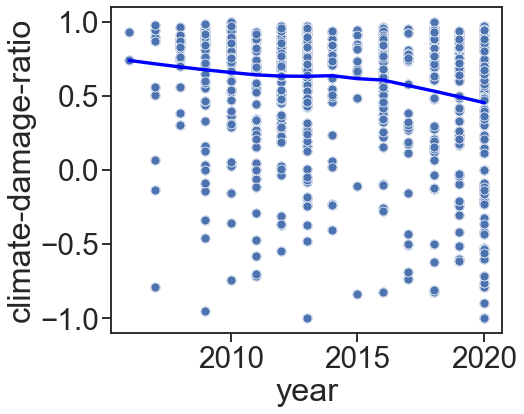

In [38]:
## Now we plot a time series using seaborn
import seaborn as sns
import matplotlib.pyplot as plt


#%matplotlib inline
sns.set()
sns.set_context("talk",font_scale=1.8)
sns.set_style("white")
sns.set_style("ticks")
plt.figure(figsize=(7, 6))

sns.regplot(data=df, lowess=True, line_kws={"color": "blue"}, x="year", y="climate-damage-ratio")
sns.scatterplot(data=df, x="year", y="climate-damage-ratio", ci=None)



In [23]:
new_df = df.drop(['tokenized_text', 'climate','damage',], axis=1)
new_df.to_csv('climate_damage.csv')